# Рынок заведений общественного питания Москвы

## Описание проекта

В данной работе будет проанализирована информация о рынке заведений общественного питания Москвы, а также даны рекомнендации для заказчика по открытию кофейни со схожей концепцией кофейни «Central Perk» из сериала "Друзья". Данные взяты с сайтов Яндекс Карты и Яндекс Бизнес, а также дополнительно привлечены данные с сайта Циан.  

**Цель**: изучить рынок заведений общественного питания Москвы, найти наиболее важные инсайты для заказчика. 

**Задачи**: Уточнить тип заведения, прайс-лист и местоположение.

**Описание данных**:

Файл `moscow_places.csv`:

 - `name` — название заведения;
 
 - `address` — адрес заведения;
 
 - `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
 
 - `hours` — информация о днях и часах работы;
 
 - `lat` — широта географической точки, в которой находится заведение;
 
 - `lng` — долгота географической точки, в которой находится заведение;
 
 - `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
 
 - `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
 
 - `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона
 
 - `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»
 
 - `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»
 
 - `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
    - 0 — заведение не является сетевым
    - 1 — заведение является сетевым
    
 - `district` — административный район, в котором находится заведение, например Центральный административный округ;
 
 - `seats` — количество посадочных мест.

**План работы**:

1. [Загрузка данных и изучение общей информации](#start):

    а) визуализировать пропуски и принять решение по их дальнейшему положению
    
    б) найти и изучить выбросы
    

2. [Провести предобработку](#preprocessing):

    а) установить, есть ли явные и неявные дубликаты 
    
    б) изменить тип данных, где это необходимо
    
    в) создать столбец `street` с названиями улиц из столбца с адресом
    
    г) создать столбец `is_24_7` с обозначением, что заведение работает ежедневно и круглосуточно (24/7)
   
   
3. [Исследовательский анализ](#EDA):
    
    а) изучить и визуализировать распределения заведений по категориям
    
    б) исследовать и визуализировать количество посадочных мест
    
    в) изучить отношение сетевых и несетевых заведений
    
    г) найти и изучить топ-15 популярных сетей в Москве
    
    д) получить информацию о районах Москвы и соотношении категорий заведений в них
    
    е) проанализировать рейтинги заведений по категориям / по районам
    
    ж) найти топ-15 улиц по количеству заведений, а также улицы, на которых находится только один объект общепита
    
    з) проанализировать начения средних чеков и построить хороплет
    
    
4. [Дополнительное исследование: зависимость часов работы заведения от категории](#supplementaire)


5. [Открытие кофейни. Рекомендации на основе проведенного анализа и ответы на вопросы](#opening):

- Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

- Есть ли круглосуточные кофейни?

- Какие у кофеен рейтинги? Как они распределяются по районам?

- На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

6. [Презентация для заказчика](#present)

7. [Выводы](#ending)

## Загрузка данных и изучение общей информации <a id="start"></a>

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")
import json
import folium
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon

In [2]:
try:
    df = pd.read_csv(r'C:\Users\User\Downloads\moscow_places.csv')
except:
    df = pd.read_csv('/datasets/moscow_places.csv')

display(df.head())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Всего в датасете представлено 8406 заведений.

Говоря о странностях в типах данных, отметим колонки с ценой и средним чеком- они почему-то оказались строкой. Исправим.

In [4]:
try:
    df['price'] = pd.to_numeric(df['price'])
except:
    pass

In [5]:
try:
    df['avg_bill'] = pd.to_numeric(df['avg_bill'])
except:
    pass

In [6]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

Обозначим пропуски: они присутствуют в колонках 
- `hours`, 

- `price`, 

- `avg_bill`, 

- `middle_avg_bill`, 

- `middle_coffee_cup`, 

- `seats`

Для выбора дальнейших действий с пропусками (замена или оставление в изначальном виде) визуализируем их.

In [7]:
def pass_value_barh(dfg):
    try:
        (
            (dfg.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind = 'barh', figsize = (19,6), rot = 0, legend = False, fontsize = 16)    
        );
        plt.title('Пропущенные значения, %' + "\n", fontsize=22, color='green')
        plt.xlabel('Процент пропусков', fontsize=16, color='green')
        plt.ylabel('Столбцы с пропусками', fontsize=16, color='green')
        plt.xlim(0, 100)
    except:
        print('пропусков не осталось :) или произошла ошибка в первой части функции ')

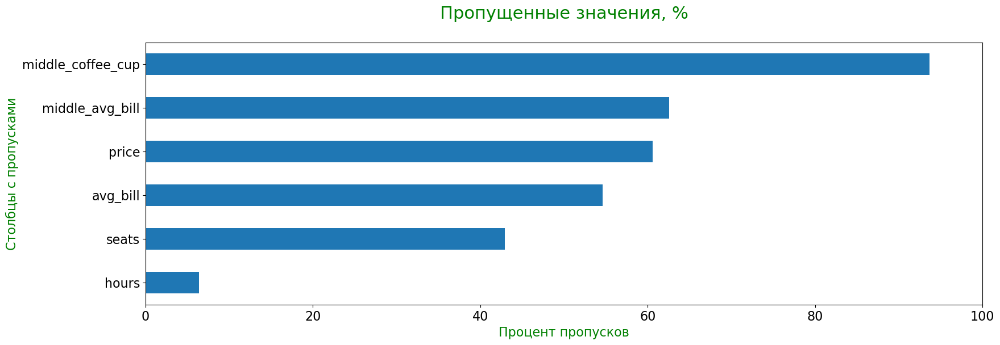

In [8]:
pass_value_barh(df[['hours', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup', 'seats']])

Как видно, "критической" можно назвать ситуацию с пропусками по колонке `middle_coffee_cup` - процент пропусков в ней почти 100%. Возможно, это произошло из-за того, что данных собрали недостаточно. Следует обратиться к коллегам за разъяснением.

Наименьшее количество пропусков в колонке 'hours' - это говорит нам о том, что за пременную с количеством посадочных мест можно не переживать и использовать ее в дальнейшем. 

К цене средней чашки же, наоборот, стоит верноуться позже. Ведь если мы решим открывать именно **кафе**, то для нас эта информация окажется очень важной.

In [9]:
df[df['category'] == 'кофейня']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46.0
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,NaN
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8356,Назис Пури,кофейня,"Москва, Люблинская улица, 61",Юго-Восточный административный округ,"ежедневно, 09:00–22:00",55.684103,37.738588,4.5,NaN,NaN,NaN,NaN,0,NaN
8365,Квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,NaN,Цена чашки капучино:100–220 ₽,NaN,160.0,0,206.0
8376,Шоколад имбирь корица,кофейня,"Москва, Грайвороновская улица, 23",Юго-Восточный административный округ,пн-пт 09:30–19:30,55.721213,37.740755,4.1,NaN,NaN,NaN,NaN,0,NaN
8385,Cafio,кофейня,"Москва, Новохохловская улица, 49",Юго-Восточный административный округ,"пн-пт 07:00–22:00; сб,вс 07:00–21:00",55.724357,37.716415,4.7,NaN,Цена чашки капучино:80–120 ₽,NaN,100.0,0,NaN


## Предобработка данных <a id="preprocessing"></a>

С пропусками цены кофе в кофейнях смириться трудно, исправим это.

Если для несетевых кофеен сложно предсказать среднюю цену чашки, то для сетевых это нетрудно. К тому же, в некоторых кофейнях (например, Cofix) цена за чашку фиксированная.

Заполним пропуски у сетевых кофеен одним значением - какой средний чек на чашку по сети.

Но для начала создадим датафрейм `all_null`, в котором отобразим названия заведений и количество НЕнулевых значений в колонке `middle_coffee_cup`, поскольку `count()` считает только их

In [10]:
df_1 = df[df['chain'] == 1]
all_null = df_1.groupby('name')['middle_coffee_cup'].count().reset_index()
print(all_null[all_null.middle_coffee_cup == 0])
all_null = all_null[all_null.middle_coffee_cup == 0].reset_index()
all_null.head()

                  name  middle_coffee_cup
0      1-я Креветочная                  0
1    10 Идеальных Пицц                  0
3             4 Сезона                  0
4          7 Сэндвичей                  0
5             8 Вафель                  0
..                 ...                ...
757       Я люблю суши                  0
758          Ян Примус                  0
759       Яндекс Лавка                  0
760       Яндекс.Лавка                  0
761     Японская кухня                  0

[690 rows x 2 columns]


,index,name,middle_coffee_cup
0,0,1-я Креветочная,0
1,1,10 Идеальных Пицц,0
2,3,4 Сезона,0
3,4,7 Сэндвичей,0
4,5,8 Вафель,0


In [11]:
#проверка

df_1[df_1['name'] == '10 Идеальных Пицц']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
430,10 Идеальных Пицц,ресторан,"Москва, улица Свободы, 48, стр. 1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.848528,37.454201,4.3,NaN,NaN,NaN,NaN,1,110.0
5069,10 Идеальных Пицц,ресторан,"Москва, улица Большие Каменщики, 9сЕ",Центральный административный округ,"ежедневно, 11:45–22:30",55.738074,37.656047,4.3,NaN,NaN,NaN,NaN,1,NaN
7590,10 Идеальных Пицц,ресторан,"Москва, улица Паустовского, 6, корп. 1",Юго-Западный административный округ,"ежедневно, 11:45–22:30",55.600224,37.539004,4.3,NaN,NaN,NaN,NaN,1,150.0


В коде выше все заведения, у которых ни в одном из филиалов не было известно значение `middle_coffee_cup`.

In [12]:
mask = df['name'].isin(all_null['name'])
df.loc[mask & df['middle_coffee_cup'].isna(), 'middle_coffee_cup'] = df.middle_coffee_cup.median()

for n in df['name'].unique():
    df.loc[(df['name'] == n) & (df['middle_coffee_cup'].isna()) & (df['chain'] == 1), 'middle_coffee_cup'] =\
    df.loc[(df['name'] == n), 'middle_coffee_cup'].median()

In [13]:
#проверка

df_2 = df[(df['chain'] == 1) & (df['middle_coffee_cup'].isna())]
df_2

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Проверим результат на примере сети кофеен Cofix

In [14]:
df[df['name'] == 'Cofix']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,60.0,1,NaN
419,Cofix,кофейня,"Москва, Сходненская улица, 37",Северо-Западный административный округ,"пн-пт 07:00–22:00; сб,вс 08:00–22:00",55.849829,37.438924,4.3,NaN,NaN,NaN,60.0,1,27.0
477,Cofix,кофейня,"Москва, Планерная улица, 7",Северо-Западный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.863422,37.434605,4.2,NaN,NaN,NaN,60.0,1,35.0
489,Cofix,кофейня,"Москва, Химкинский бульвар, вл7-23",Северо-Западный административный округ,"ежедневно, 09:00–22:00",55.850811,37.444491,4.0,NaN,Цена чашки капучино:от 60 ₽,NaN,60.0,1,NaN
518,Cofix,кофейня,"Москва, Фестивальная улица, 2А",Северный административный округ,"пн-пт 07:00–23:00; сб,вс 08:00–23:00",55.854333,37.476018,3.9,NaN,Цена чашки капучино:от 60 ₽,NaN,60.0,1,189.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7595,Cofix,кофейня,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.607778,37.532554,4.1,средние,Цена чашки капучино:60–180 ₽,NaN,120.0,1,60.0
7722,Cofix,кофейня,"Москва, Варшавское шоссе, 140",Южный административный округ,"ежедневно, 09:00–22:00",55.611885,37.607043,4.1,NaN,NaN,NaN,60.0,1,NaN
7732,Cofix,кофейня,"Москва, улица Красного Маяка, 2Б",Южный административный округ,"ежедневно, 10:00–22:00",55.611225,37.606696,4.1,NaN,NaN,NaN,60.0,1,70.0
7910,Cofix,кофейня,"Москва, Ореховый бульвар, 22А",Южный административный округ,"ежедневно, 09:00–22:00",55.612312,37.731524,4.2,NaN,Цена чашки капучино:от 60 ₽,NaN,60.0,1,80.0


In [15]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    4929
chain                   0
seats                3611
dtype: int64

Мы несколько сократили количество пропусков в колонке `middle_coffee_cup` за счет данных о сетевых кофейнях. Остальные же пропуски лучше оставить, так как цены в несетевых кофейнях могут значительно разниться.

Говоря о разнице между значениями, нельзя не посмотреть на общую картину, а именно, есть ли неожиданные выбросы в данных.

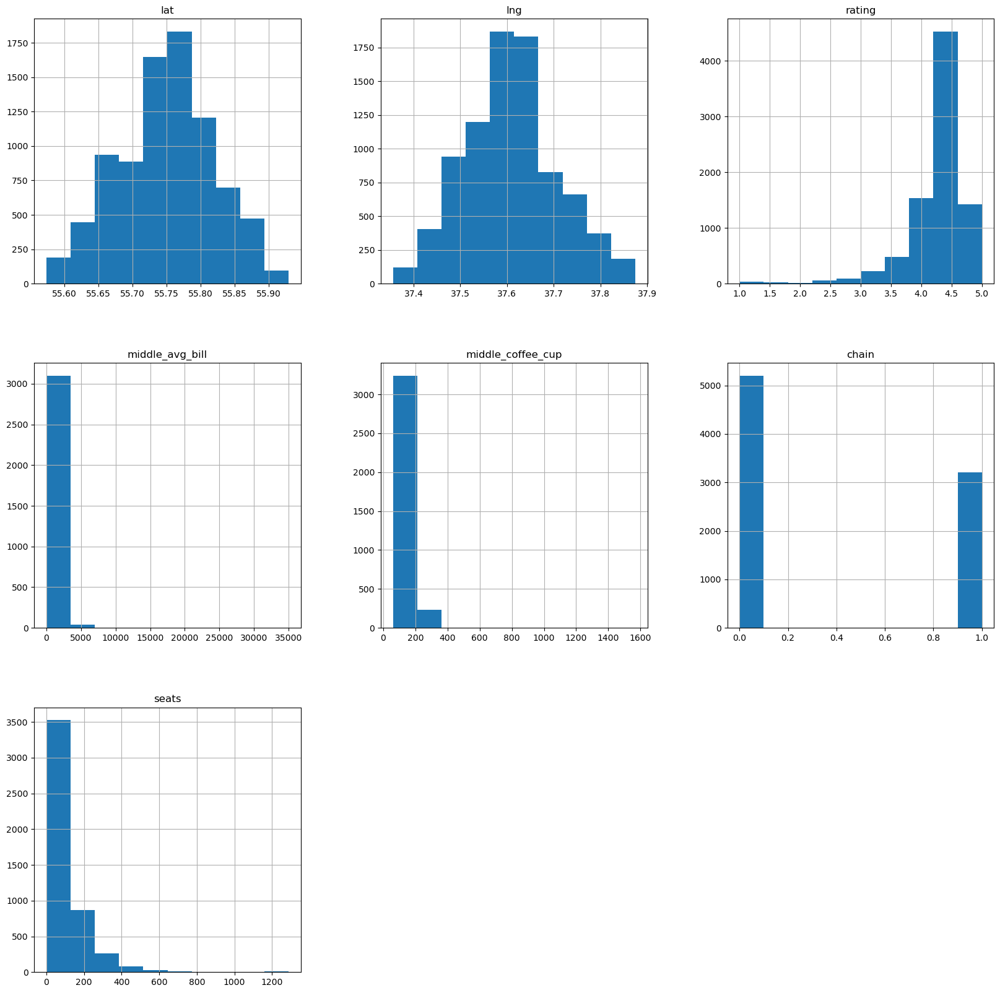

In [16]:
df.hist(figsize=(20, 20));

Чуть выше - визуализация количественных переменных в датасете. Мы проверили данные на неожиданные выбросы. На первый взгляд все хорошо. Географическая широта и долгота в пределах нормы - то есть вокруг Москвы, рейтинг посетителей не выходит за рамки 5. Немного смущает макимальное количество посадочных мест - 500. Проверим, насколько много таких высоких значений. 

count    4795.000000
mean      108.421689
std       122.833396
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

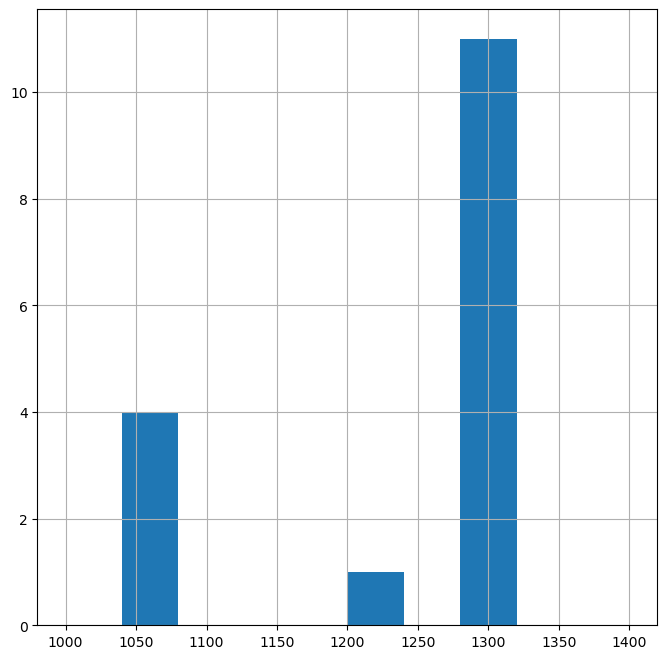

In [17]:
df.seats.hist(range=(1000, 1400), figsize=(8, 8))
df.seats.describe()

А вот и скрытая аномалия. Вопрос - убрать или оставить? Я предлагаю оставить данные значения, поскольку, хоть они и кажутся чрезмерно большими, таковых в датасете имеется больше 10, если их убрать это может сильно навредить данным (подтверждение см. ниже). Поэтому оставим крупные данные.

In [18]:
df.shape  #(8406, 14)
df1 = df.query('seats < 1050')
df1.shape

(4783, 14)

Рассмотрим поближе данные из колонки `chain` - они не должны быть ничем иным, как 0 или 1.

In [19]:
df.chain.unique()

array([0, 1], dtype=int64)

Отлично, тут все в порядке. Кстать, теперь, благодаря гистограмме, можно увидеть, что несетевых заведений больше.

Теперь посмотрим на среднюю цену чашки.

count    3477.000000
mean      167.623526
std        42.280792
min        60.000000
25%       169.000000
50%       169.000000
75%       169.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

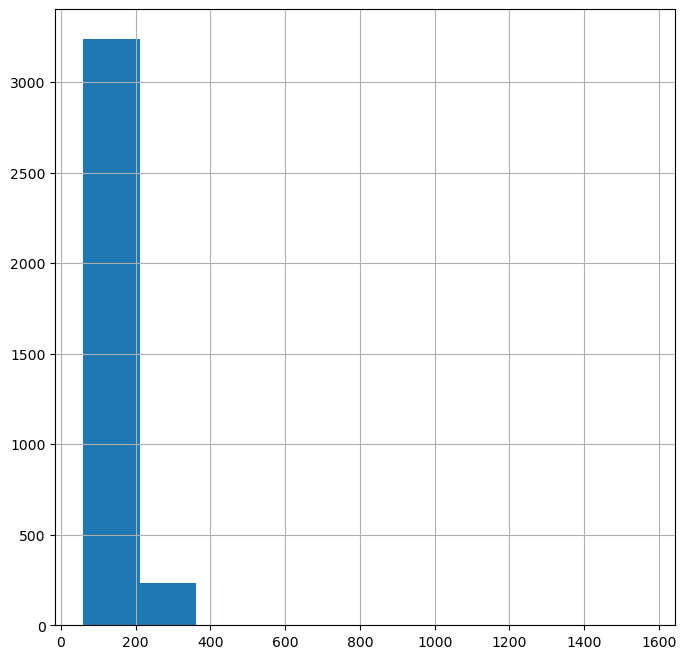

In [20]:
df.middle_coffee_cup.hist(figsize=(8, 8));
df.middle_coffee_cup.describe()

Кофе за 1568 руб... Кажется, немного оверпрайс. Посмотрим, сколько значений в этом диапазоне.

count    3477.000000
mean      167.623526
std        42.280792
min        60.000000
25%       169.000000
50%       169.000000
75%       169.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

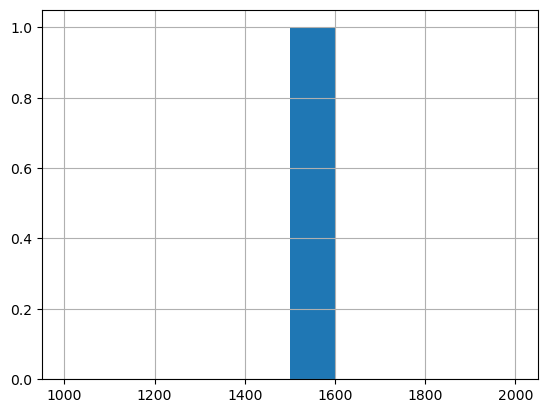

In [21]:
df.middle_coffee_cup.hist(range=(1000, 2000));
df.middle_coffee_cup.describe()

Как и ожидалось, всего 1 значение. Уберем этот выброс.

In [22]:
df = df.query('middle_coffee_cup != 1568')
df.shape

(8405, 14)

На очереди `middle_avg_bill`

count     3149.000000
mean       958.053668
std       1009.732845
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

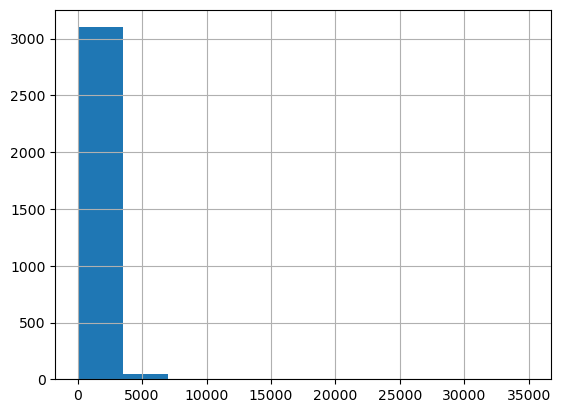

In [23]:
df.middle_avg_bill.hist();
df.middle_avg_bill.describe()

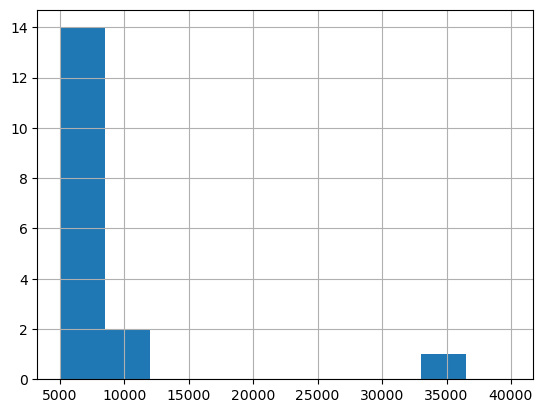

In [24]:
df.middle_avg_bill.hist(range=(5000, 40000));

Похоже, закралась опечатка. Но перед тем, как что-то с ней сделать, посмотрим, что же это за ресторан с таким высоким чеком.

In [26]:
df[df['middle_avg_bill'] == 35000]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7177,Кафе,ресторан,"Москва, Каширское шоссе, 23, стр. 2",Южный административный округ,"ежедневно, круглосуточно",55.65745,37.646665,4.1,высокие,Средний счёт:20000–50000 ₽,35000.0,NaN,0,100.0


Что ж, кафе с названием "Кафе" действительно существует, более того, за счет того, что оно принадлежит больнице, цены в нем действительно высоки. Однако, ознакомившись с отзывами на данное заведение (при помощи открытых источников), у меня сложилось впечатление, что средний чек здесь все-таки 3_500, а не 35_000, не настолько оно элитарное. Давайте примем это как факт и подкорректируем данные.

In [27]:
df.loc[df['middle_avg_bill'] == 35000, 'middle_avg_bill'] = 3500
df.loc[df['avg_bill'] == 'Средний счёт:20000–50000 ₽', 'avg_bill'] = 'Средний счёт:2000–5000 ₽'

In [28]:
df[df['middle_avg_bill'] == 3500]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1800,Promenade Lounge,кафе,"Москва, Ленинградский проспект, 36, стр. 33",Северный административный округ,"ежедневно, круглосуточно",55.787416,37.566735,4.4,высокие,Средний счёт:3000–4000 ₽,3500.0,NaN,0,90.0
3439,China Club,ресторан,"Москва, улица Красина, 21",Центральный административный округ,"ежедневно, 12:00–23:00",55.768974,37.585914,4.5,высокие,Средний счёт:3000–4000 ₽,3500.0,NaN,0,88.0
3447,Grace Bistro,ресторан,"Москва, улица Спиридоновка, 25/20с1",Центральный административный округ,"пн-пт 08:00–23:00; сб,вс 10:00–23:00",55.762797,37.588985,4.7,высокие,Средний счёт:2500–4500 ₽,3500.0,NaN,0,NaN
3702,Farang,ресторан,"Москва, Малая Никитская улица, 24, стр. 1",Центральный административный округ,"ежедневно, 12:00–00:00",55.759265,37.587306,4.3,высокие,Средний счёт:3500 ₽,3500.0,NaN,0,25.0
3975,Раковая,"бар,паб","Москва, Усачёва улица, 22",Центральный административный округ,"пн-чт 10:00–01:00; пт,сб 10:00–02:00; вс 10:00...",55.727582,37.569834,4.5,высокие,Средний счёт:2000–5000 ₽,3500.0,169.0,1,127.0
4094,Rest,ресторан,"Москва, Пречистенская набережная, 7",Центральный административный округ,"ежедневно, 12:00–00:00",55.736658,37.601271,4.5,высокие,Средний счёт:3000–4000 ₽,3500.0,NaN,0,54.0
4331,Оджахури,ресторан,"Москва, Садовая-Черногрязская улица, 22, стр. 1",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.764406,37.655277,4.6,высокие,Средний счёт:от 3500 ₽,3500.0,NaN,0,98.0
4881,Стейк Хаус Бутчер,ресторан,"Москва, Садовническая набережная, 75",Центральный административный округ,"ежедневно, 12:00–00:00",55.736038,37.640805,4.9,высокие,Средний счёт:3500 ₽,3500.0,NaN,0,100.0
4938,Stories,ресторан,"Москва, Котельническая набережная, 1/15кВК",Центральный административный округ,"пн-пт 08:00–23:00; сб,вс 10:00–23:00",55.748106,37.644427,4.6,высокие,Средний счёт:3500 ₽,3500.0,NaN,0,NaN
5724,Garum,ресторан,"Москва, Мичуринский проспект, 16",Западный административный округ,"пн-пт 15:00–01:00; сб,вс 13:00–23:00",55.702328,37.505930,4.5,высокие,Средний счёт:2000–5000 ₽,3500.0,NaN,0,60.0


Теперь перейдем к **дубликатам** и сначала изучим явные

In [29]:
df.duplicated().unique()

array([False])

Явных дупликатов не оказалось, попытаемся найти неявные. Для этого посмотрим на списрк уникальных назаний заведений из датасета.

In [33]:
unique_names = df.name.unique().tolist()
unique_names[:20]

['WoWфли',
 'Четыре комнаты',
 'Хазри',
 'Dormouse Coffee Shop',
 'Иль Марко',
 'Sergio Pizza',
 'Огни города',
 'Mr. Уголёк',
 'Donna Maria',
 'Готика',
 'Great Room Bar',
 'Шашлык Шефф',
 'Заправка',
 'Буханка',
 'У Сильвы',
 'Дом обеда',
 'База Стритфуд',
 'Чайхана Беш-Бармак',
 'Час-Пик',
 'Пекарня']

In [34]:
df[df.duplicated(subset=['name', 'address']) == True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Изучив полученный список с названиями заведений, можно полумать, что неявные дубликаты есть. Однако, в данном случае, это названия сетей. Напирмер, в списке можно найти не одно названий "Му-Му" или 'Хинкали-Gали!' и т.п., однако, при более близком рассмотрении, становится очевидно, что строки не дублируются. Также не замечено названий "с опечатками".

Также проверила наличие совпадений в колонках с название заведения и адресом, однако это снова доказало, что дубликаты в датасете отсутствуют.

Создадим столбец `street` с названиями улиц из столбца с адресом

In [36]:
df['street'] = df['address'].str.split(', ').str[1]
df['street'].head(20)

0               улица Дыбенко
1               улица Дыбенко
2          Клязьминская улица
3     улица Маршала Федоренко
4         Правобережная улица
5              Ижорская улица
6          Клязьминская улица
7          Клязьминская улица
8           Дмитровское шоссе
9             Ангарская улица
10         Левобережная улица
11    улица Маршала Федоренко
12                       МКАД
13            Базовская улица
14            Ангарская улица
15    улица Бусиновская Горка
16            Базовская улица
17        Ленинградское шоссе
18          Коровинское шоссе
19            Ижорский проезд
Name: street, dtype: object

Теперь создадим столбец `is_24_7` с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
- логическое значение True — если заведение работает ежедневно и круглосуточно;

- логическое значение False — в противоположном случае.

In [37]:
df['is_24_7'] = df['hours'].str.contains('круглосуточно', case=False)
df.head(15)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,169.0,1,148.0,Правобережная улица,False
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN,Ижорская улица,False
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0,Клязьминская улица,False
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0,Клязьминская улица,False
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0,Дмитровское шоссе,False
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0,Ангарская улица,False


В коде выше мы убедились, что поставленное условие работает.

## Какие категории заведений представлены в данных? <a id="EDA"></a>

Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. 

Построим визуализации. 

Затем ответим на вопрос о распределении заведений по категориям.

In [38]:
df.category.unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [39]:
fig = px.histogram(df, 
                   x='category',
                   title='Частота встречаемости категории заведения', 
                   nbins=1000,
                   color_discrete_sequence=['#75C144'])
fig.update_xaxes(title_text='Тип заведения') 
fig.update_yaxes(title_text='Частота')

fig.update_layout(xaxis={'categoryorder':'total descending'}) 

fig.show() 

Итак, самый популярный тип заведения - кафе. Их в Москве 2378 штук. И наоборот, наименее популярное - булочная, их всего 256.

Какой из этого можно сделать вывод? Конкуренция среди булочных, а также столовых (которых не сильно больше) заметно ниже, значит открыться будет проще. С другой стороны, если их так мало, может они не особо популярны у посетителей?

Исследуем количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее, построим визуализации.

In [40]:
seats_grouped = df.groupby('category')['seats'].median().reset_index()

fig = px.bar(seats_grouped, x='category', y='seats', title='Количество мест по категориям', color_discrete_sequence=['#75C144'])

fig.update_xaxes(title_text='Категория')
fig.update_yaxes(title_text='Количество мест')

fig.update_layout(xaxis={'categoryorder':'total descending'})

fig.show()

In [41]:
df.groupby('category')['seats'].median()

category
бар,паб            82.5
булочная           50.0
быстрое питание    65.0
кафе               60.0
кофейня            80.0
пиццерия           55.0
ресторан           86.0
столовая           75.5
Name: seats, dtype: float64

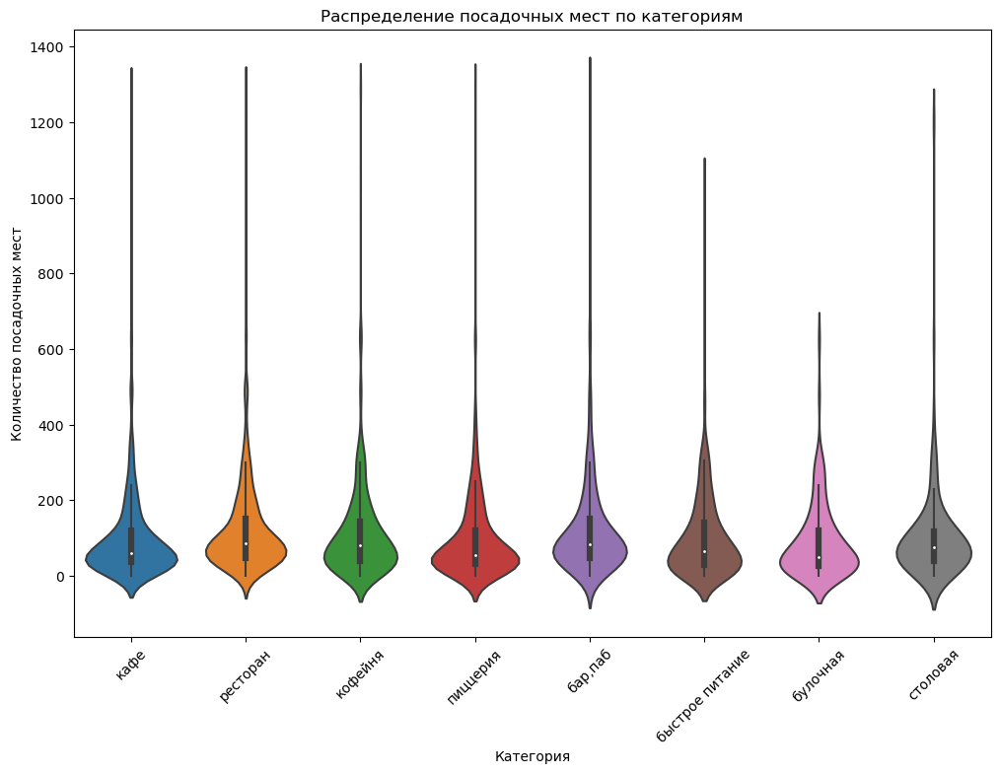

In [42]:
plt.figure(figsize=(12, 8))

ax = sns.violinplot(x='category', y='seats', data=df)
plt.xticks(rotation=45)

ax.set(
    title='Распределение посадочных мест по категориям',
    xlabel='Категория',
    ylabel='Количество посадочных мест'
);

**Выводы**: по количеству посадочных мест, в среднем, лидирует ресторан, следом идут кафе и кофейни.

Меньше всего посадочных мест в булочных и общепите.

Рассмотрим и изобразим соотношение сетевых и несетевых заведений в датасете. 

Постараемся ответить на вопрос, каких заведений больше.

In [43]:
df['chain'] = df['chain'].map({1: 'Сетевые', 0: 'Несетевые'})

In [44]:
fig = px.histogram(df, 
                   x='chain',
                   title='Каких заведений больше: сетевых или несетевых', 
                   nbins=10,
                   color_discrete_sequence=['#75C144'])
fig.update_xaxes(title_text='Тип заведения') 
fig.update_yaxes(title_text='Частота')
fig.show() 

Как следует из графика выше - несетевых заведений больше, их количество составляет 5201. Сетевых меньше - 3204.

Какие категории заведений чаще являются сетевыми? 

In [45]:
chain_percentage = df.groupby('category')['chain'].value_counts(normalize=True) * 100
category_chain = chain_percentage.loc[chain_percentage.index.get_level_values('chain') == 'Сетевые'].round(2).reset_index(name='chain_type')
category_chain

,category,chain,chain_type
0,"бар,паб",Сетевые,22.09
1,булочная,Сетевые,61.33
2,быстрое питание,Сетевые,38.47
3,кафе,Сетевые,32.76
4,кофейня,Сетевые,50.92
5,пиццерия,Сетевые,52.13
6,ресторан,Сетевые,35.73
7,столовая,Сетевые,27.94


In [46]:
fig = px.bar(category_chain, x='category', y='chain_type', title='Сетевые заведения в каждой категории, %',
             color_discrete_sequence=['#75C144'])

fig.update_xaxes(title_text='Категория')
fig.update_yaxes(title_text='Процент сетевых')

fig.update_layout(xaxis={'categoryorder':'total descending'})

fig.show()

Итак, мы выяснили, что больше всего сетевых булочных, также в топ-3 входят пиццерии и кофейни. Самые несетевые заведения - бары и пабы.

Теперь сгруппируем данные по названиям заведений и найдем топ-15 популярных сетей в Москве. 

*Под популярностью понимается количество заведений этой сети в регионе.*

Визуализируем данные. Постараемся выделить признак, который их объединяет.

In [47]:
net = df[df['chain'] == 'Сетевые']
net.tail()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
8317,Беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,169.0,Сетевые,NaN,Кузьминская улица,False
8340,Семейный Очаг,ресторан,"Москва, Шоссейная улица, 13",Юго-Восточный административный округ,"ежедневно, 12:00–00:00",55.688104,37.725197,4.3,средние,Средний счёт:до 1000 ₽,1000.0,169.0,Сетевые,98.0,Шоссейная улица,False
8372,Чайхана Sabr,ресторан,"Москва, улица Хлобыстова, 22",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.716361,37.813436,3.9,средние,Средний счёт:150–350 ₽,250.0,169.0,Сетевые,32.0,улица Хлобыстова,False
8379,Лагман Хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,169.0,Сетевые,40.0,Новороссийская улица,False
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,169.0,Сетевые,150.0,Люблинская улица,True


In [48]:
counts = net.groupby('name')['name'].count().sort_values(ascending=False).head(15)

fig = px.bar(counts, x=counts.index, y=counts.values, title='Самые популярные сети')
fig.update_xaxes(title_text='Название сети')
fig.update_yaxes(title_text='Количество заведений')
fig.show()

In [49]:
fig = px.pie(names=counts.index, values=counts.values, title='Топ-15 ресторанов по количеству записей', \
             color_discrete_sequence=['green', 'darkgreen', 'lightgreen', 'yellowgreen', 'forestgreen', \
                                      'limegreen', 'chartreuse', 'olive', 'greenyellow', 'lawngreen', \
                                      'palegreen', 'mediumspringgreen', 'springgreen', 'seagreen', 'mediumseagreen'])
fig.show()

Посмотрим, к каким категориям относятся ТОП-15 сетей:

In [53]:
top_names = net.loc[net['name'].isin(counts.index), 'category']
top_names = top_names.value_counts().reset_index()
top_names

,category,count
0,кофейня,335
1,ресторан,186
2,пиццерия,151
3,кафе,100
4,булочная,25
5,быстрое питание,12
6,"бар,паб",4
7,столовая,2


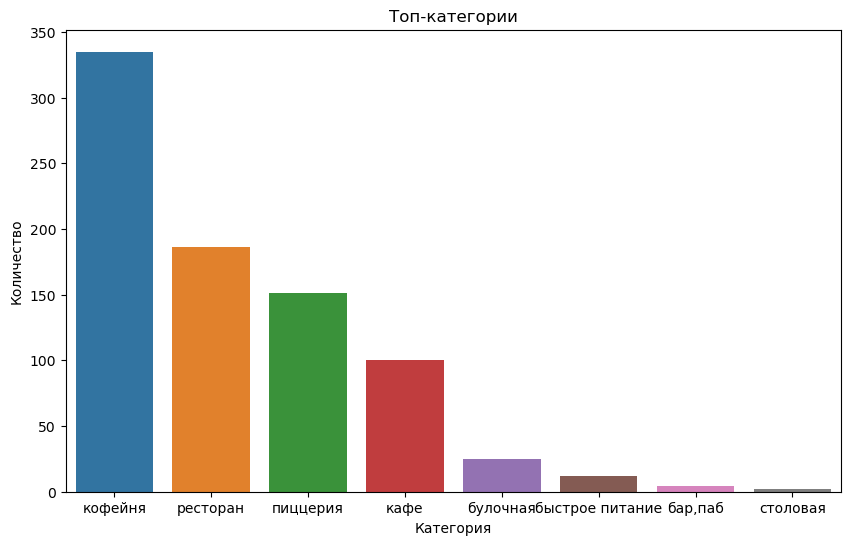

In [62]:
plt.figure(figsize=(10, 6))
sns.barplot(x="category", y="count", data=top_names)
plt.xlabel("Категория")
plt.ylabel("Количество")
plt.title("Топ-категории")
plt.show()

Рассмотрим, какие административные районы Москвы присутствуют в датасете? 

Сначала отобразим общее количество заведений, а затем, с помощью сводной таблицы, значения по районам

In [63]:
df.shape

(8405, 16)

Всего у нас представлено 8405 уникальных заведений.

In [64]:
df.groupby('district')['category'].count().sort_values(ascending=False)

district
Центральный административный округ         2242
Северный административный округ             900
Южный административный округ                892
Северо-Восточный административный округ     891
Западный административный округ             851
Восточный административный округ            797
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Северо-Западный административный округ      409
Name: category, dtype: int64

Из них всего (по всем категориям) больше всего заведений в ЦАО. За ним с небольшим отрывом идут ЮАО и СВАО. Меньше всего заведений представлено в СЗАО.

In [65]:
dist = df.pivot_table(index=['district', 'category'], values='name', aggfunc='count').reset_index()
dist.tail(10)

,district,category,name
62,Юго-Западный административный округ,ресторан,168
63,Юго-Западный административный округ,столовая,17
64,Южный административный округ,"бар,паб",68
65,Южный административный округ,булочная,25
66,Южный административный округ,быстрое питание,85
67,Южный административный округ,кафе,264
68,Южный административный округ,кофейня,131
69,Южный административный округ,пиццерия,73
70,Южный административный округ,ресторан,202
71,Южный административный округ,столовая,44


Теперь перейдем к визуализации. Однако перед этим сделаем небольшой подготовительный этап - изменим содержание столбца `district` так, чтобы осталось только само название, без слов "административный округ". 

Это позволит сделать визуализацию более приятной.

In [66]:
df_less_words = df.copy()
df_less_words['district'] = df_less_words['district'].str.split().str[0]
df_less_words.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,Несетевые,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,Несетевые,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,Несетевые,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевые,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,169.0,Сетевые,148.0,Правобережная улица,False


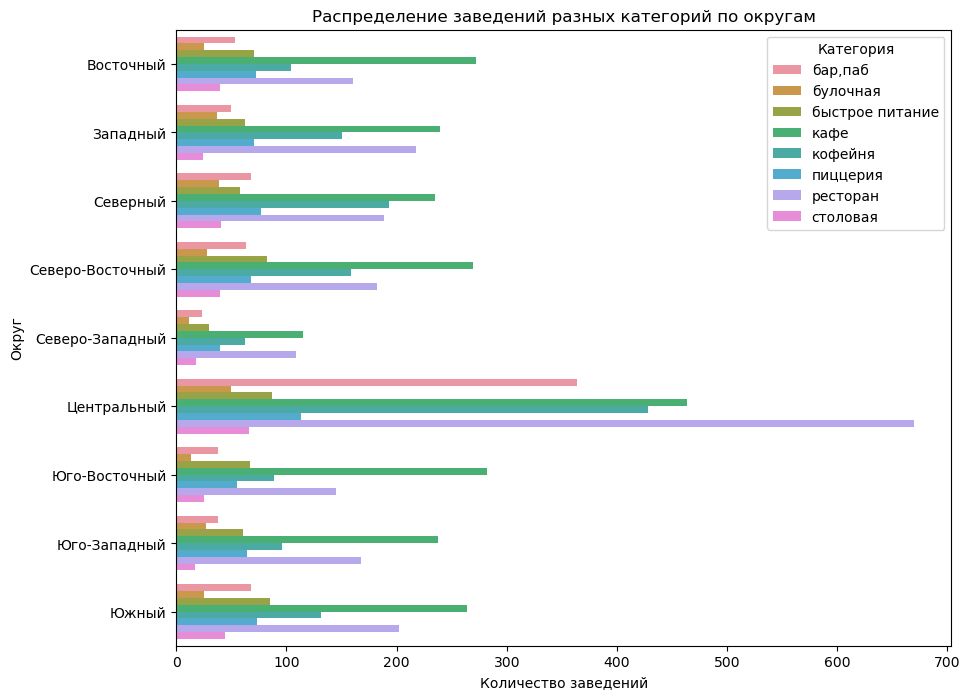

In [67]:
sns.set_palette('flare')

pivot_table_counts = df_less_words.pivot_table(index=['district', 'category'], values='name', aggfunc='count').reset_index()

plt.figure(figsize=(10, 8))
sns.barplot(x='name', y='district', hue='category', data=pivot_table_counts, ci=None)
plt.xlabel('Количество заведений')
plt.ylabel('Округ')
plt.title('Распределение заведений разных категорий по округам')
plt.legend(title='Категория')

plt.show()

In [68]:
pivot_table_counts.columns = ['округ', 'категория', 'количество']

fig = px.bar(pivot_table_counts, x="количество", y="округ", color="категория", orientation='h',
             color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title="Распределение заведений разных категорий по округам", xaxis_title='Округ', 
                  yaxis_title='Количество заведений', yaxis={'categoryorder':'total ascending'})

fig.show()

Визуализируем распределение средних рейтингов по категориям заведений. 

Так мы увидим, сильно ли различаются усреднённые рейтинги в разных типах общепита

In [69]:
mean_rating = df.groupby('category')['rating'].mean().round(2).sort_values(ascending=False)
mean_rating

category
бар,паб            4.39
пиццерия           4.30
ресторан           4.29
кофейня            4.28
булочная           4.27
столовая           4.21
кафе               4.12
быстрое питание    4.05
Name: rating, dtype: float64

Средний рейтинг может не отражать реальной картиныю Давайте на всякий случай посмотрим еще и на медиану.

In [70]:
df.groupby('category')['rating'].median()

category
бар,паб            4.4
булочная           4.3
быстрое питание    4.2
кафе               4.2
кофейня            4.3
пиццерия           4.3
ресторан           4.3
столовая           4.3
Name: rating, dtype: float64

На этот раз более показательной оказалась средняя велечина. Визуализируем ее.

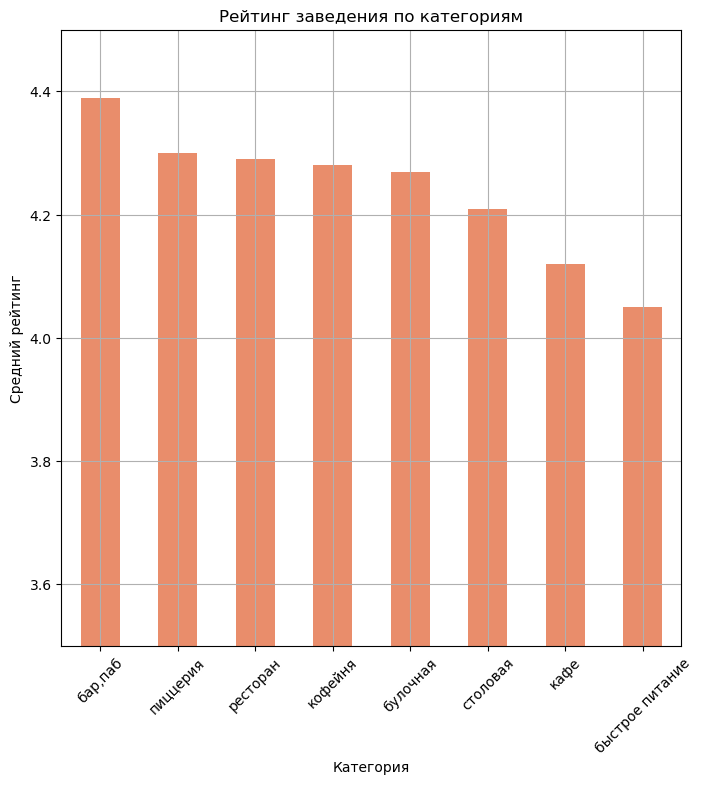

In [71]:
plt.figure(figsize=(8,8))
mean_rating.plot(kind='bar')
plt.grid('gridOn')
plt.ylim(3.5, 4.5)

plt.title('Рейтинг заведения по категориям')
plt.xlabel('Категория')
plt.ylabel('Средний рейтинг')

plt.xticks(rotation=45)
plt.show()

Как видно из визуализации, наиболее высокие средние рейтинги у баров и пабов, а наименее - у заведений формата быстрого питания.

Может показаться странным, что у категории "кафе" средние рейтинги невысоки по сравнению с остальными видами, однако это может быть связано с тем, что "кафе" - самая популярная категория, следовательно, и отзывов на нее больше. Это подтверждается таблицей выше, где мы смотрели медиану - там кафе занимает более высокие позиции. Впрочем, как и быстрое питание.

Перейдем к построению **хороплета** со средним рейтингом заведений каждого района. 

Сначала создадим таблицу со средним рейтингом заведений каждого района.

In [72]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean').sort_values('rating')
rating_df

,district,rating
6,Юго-Восточный административный округ,4.101120
3,Северо-Восточный административный округ,4.148260
7,Юго-Западный административный округ,4.172920
0,Восточный административный округ,4.174153
1,Западный административный округ,4.181551
8,Южный административный округ,4.184417
4,Северо-Западный административный округ,4.208802
2,Северный административный округ,4.239778
5,Центральный административный округ,4.377520


In [73]:
import requests

url = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
response = requests.get(url)

geo_json = response.json()

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [74]:
#файл 
state_geo = ('https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson')

moscow_lat, moscow_lng = 55.751244, 37.618423

# карта Мск
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

m

Найдем топ-15 улиц по количеству заведений. Построим график рmаспределения количества заведений и их категорий по этим улицам.

In [75]:
streets = df.groupby('street')['category'].count().sort_values(ascending=False).head(15)
streets

street
проспект Мира             184
Профсоюзная улица         122
проспект Вернадского      108
Ленинский проспект        107
Ленинградский проспект     95
Дмитровское шоссе          88
Каширское шоссе            77
Варшавское шоссе           76
Ленинградское шоссе        70
МКАД                       65
Люблинская улица           60
улица Вавилова             55
Кутузовский проспект       54
улица Миклухо-Маклая       49
Пятницкая улица            48
Name: category, dtype: int64

In [76]:
streets_df = df.copy()
streets_df = streets_df[streets_df['street'].isin(streets.index)]
streets_df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,Несетевые,79.0,Дмитровское шоссе,False
12,Заправка,кафе,"Москва, МКАД, 80-й километр, 1",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,Средний счёт:330 ₽,330.0,NaN,Несетевые,NaN,МКАД,False
17,Чайхана Беш-Бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,Несетевые,96.0,Ленинградское шоссе,True
26,Пикочино,пиццерия,"Москва, Дмитровское шоссе, 107к2",Северный административный округ,"пн-чт 11:00–22:00; пт,сб 11:00–23:00; вс 11:00...",55.879390,37.541228,4.5,средние,Средний счёт:300–1500 ₽,900.0,NaN,Несетевые,NaN,Дмитровское шоссе,False
28,Mafe,кафе,"Москва, МКАД, 78-й километр, 14к1",Северный административный округ,"ежедневно, 10:00–19:00",55.893061,37.501319,3.8,средние,Средний счёт:400–600 ₽,500.0,NaN,Несетевые,NaN,МКАД,False


In [77]:
steet_pivot = streets_df.pivot_table(index=['street', 'category'], values='name', aggfunc='count')
steet_pivot.head(10)

name
street            category             
Варшавское шоссе  бар,паб             6
                  быстрое питание     7
                  кафе               18
                  кофейня            14
                  пиццерия            4
                  ресторан           20
                  столовая            7
Дмитровское шоссе бар,паб             6
                  булочная            2
                  быстрое питание    10

In [78]:
steet_pivot_reset = steet_pivot.reset_index()

steet_pivot_reset.columns = ['улица', 'категория', 'количество']

fig = px.bar(steet_pivot_reset, x="улица", y="количество", color="категория", 
             color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title="Распределение категорий заведений на ТОП-15 улицах", xaxis_title='Улица', 
                  yaxis_title='Количество заведений', xaxis={'categoryorder':'total descending'})

fig.show()

Найдем улицы, на которых находится только один объект общепита. 

Что можно сказать об этих заведениях?

In [79]:
df_solo = df.copy()
street_counts = df_solo['street'].value_counts()
unique_streets = street_counts[street_counts == 1].index

df_solo = df_solo[df_solo['street'].isin(unique_streets)]
df_solo.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
15,Дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,Несетевые,180.0,улица Бусиновская Горка,False
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,Несетевые,NaN,Прибрежный проезд,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,169.0,Сетевые,NaN,парк Левобережный,False
58,Coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,187.5,Сетевые,NaN,Угличская улица,False
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,170.0,Сетевые,NaN,ландшафтный заказник Лианозовский,False


In [80]:
print(df_solo.is_24_7.value_counts())
print()
print(df_solo.chain.value_counts())

is_24_7
False    400
True      31
Name: count, dtype: int64

chain
Несетевые    325
Сетевые      133
Name: count, dtype: int64


Удивительно, но среди затаившихся заведений у нас присутствуют и сетевые, и те, которые работают круглосуточно

Давайте отобразим заведения на карте, возможно, это даст нам какую-то подсказку.

In [81]:
# карта Мск
msk = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Заведения-одиночки на карте',
).add_to(msk)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(msk)  #при условии, что карта уже создана

#пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df_solo.apply(create_clusters, axis=1)

msk

На карте уже заметно, что большинство заведений располагаются на севере - веверо-западе Москвы. В Цетральном округе их также довольно много, однако, если мысленно разделить его горизонтально пополам, то снова получится, что на севере чуть больше заведений. Однако я не считаю, что этот параметр показателен. Продолжим исследование.

In [82]:
df_solo.groupby('category')['name'].count().sort_values(ascending=False)

category
кафе               160
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: name, dtype: int64

Больше всего заведений представлено категориями кафе, ресторанов и кофеен, за ними с большим отрывом идут бары и пабы. А как это соотносится с остальными?

In [83]:
df.groupby('category')['name'].count().sort_values(ascending=False)

category
кафе               2378
ресторан           2043
кофейня            1412
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: name, dtype: int64

Результат практически одинаковый. Топ-3 лидеров категорий сохраняются, как и булочные на последнем месте. Перестановка коснулась пиццерий - в единственных заведениях на улице пиццерий меньше, чем в общем датафрейме.

**Таким образом, не удалось выявить достаточно обоснованных закономерностей или особенностей у тех улиц, на которых находится только один объект общепита.**

Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. 

Найдем медиану этого столбца для каждого района, используя это значение в качестве ценового индикатора района. Снова построим хороплет по полученным значениям для каждого района. 

Проанализируем цены в центральном административном округе и других и ответим на вопрос, как удалённость от центра влияет на цены в заведениях

In [84]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,Несетевые,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,Несетевые,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,Несетевые,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевые,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,169.0,Сетевые,148.0,Правобережная улица,False


In [85]:
indicator = df.groupby('district')['middle_avg_bill'].median().sort_values(ascending=False).reset_index()
indicator

,district,middle_avg_bill
0,Западный административный округ,1000.0
1,Центральный административный округ,1000.0
2,Северо-Западный административный округ,700.0
3,Северный административный округ,650.0
4,Юго-Западный административный округ,600.0
5,Восточный административный округ,575.0
6,Северо-Восточный административный округ,500.0
7,Южный административный округ,500.0
8,Юго-Восточный административный округ,450.0


In [86]:
df['indic'] = df['district'].map(indicator.set_index('district')['middle_avg_bill'])
df.tail()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,Несетевые,86.0,Профсоюзная улица,False,600.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,Несетевые,150.0,Пролетарский проспект,False,500.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,Несетевые,150.0,Люблинская улица,True,450.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,169.0,Сетевые,150.0,Люблинская улица,True,450.0
8405,Kebab Time,кафе,"Москва, Россошанский проезд, 6",Южный административный округ,"ежедневно, круглосуточно",55.598229,37.604702,3.9,NaN,NaN,NaN,NaN,Несетевые,12.0,Россошанский проезд,True,500.0


Теперь нарисуем карту, за основу взяв данные из нового столбца

In [87]:
# карта Мск
mos = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=df,
    columns=['district', 'indic'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Заведения-одиночки на карте',
).add_to(mos)

mos

In [88]:
mos1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='OpenStreetMap')

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(mos1) 

#пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['indic']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

mos1

## Дополнительное исследование <a id="supplementaire"></a>

Проанализируем зависимость часов работы заведения от категории.

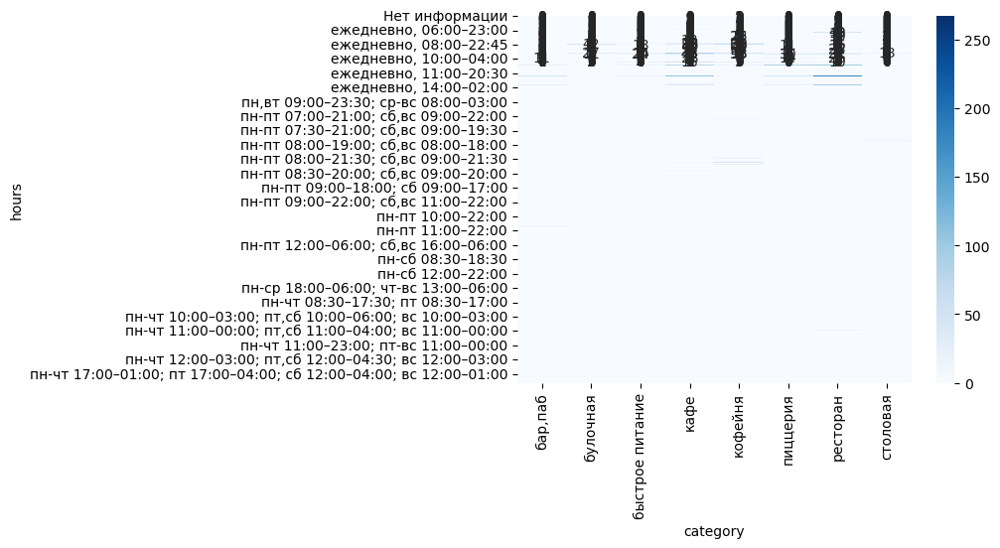

In [89]:
#sns.scatterlpot(x="hours", y="category", data=df);
sns.heatmap(pd.crosstab(df['hours'], df['category']), annot=True, cmap='Blues')
plt.show()

Не самый понятный график. Уберем часть данных. Для начала посмотрим на выборку только тех заведений, которые работают ежедневно. Какие категории здесь представлены? В каких округах чаще всего находятся такие заведения?

In [90]:
every_day = df[df['hours'].str.contains('ежедневно').fillna(False)]

In [91]:
print(df.shape)
print(every_day.shape)
every_day.tail()

(8405, 17)
(5019, 17)


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,Несетевые,86.0,Профсоюзная улица,False,600.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,Несетевые,150.0,Пролетарский проспект,False,500.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,Несетевые,150.0,Люблинская улица,True,450.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,169.0,Сетевые,150.0,Люблинская улица,True,450.0
8405,Kebab Time,кафе,"Москва, Россошанский проезд, 6",Южный административный округ,"ежедневно, круглосуточно",55.598229,37.604702,3.9,NaN,NaN,NaN,NaN,Несетевые,12.0,Россошанский проезд,True,500.0


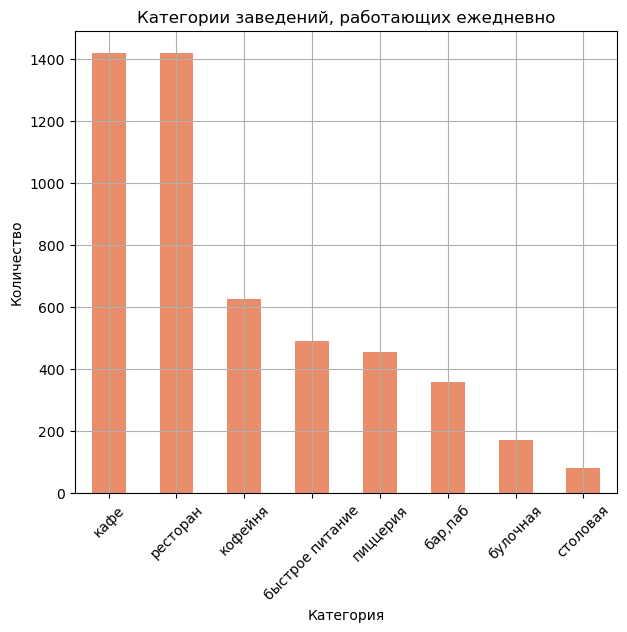

In [92]:
category_counts = every_day.groupby('category')['name'].count().sort_values(ascending=False)

plt.figure(figsize=(7, 6))
category_counts.plot(kind='bar')
plt.grid('gridOn')
plt.xticks(rotation=45)

plt.title('Категории заведений, работающих ежедневно')
plt.xlabel('Категория')
plt.ylabel('Количество')

plt.show()

Никаких новых инсайтов - в лидерах все также кафе и рестораны с кофейнями. Посмотрим на заведения, которые работают круглосуточно, может там найдутся какие-то новые выводы?

(772, 17)


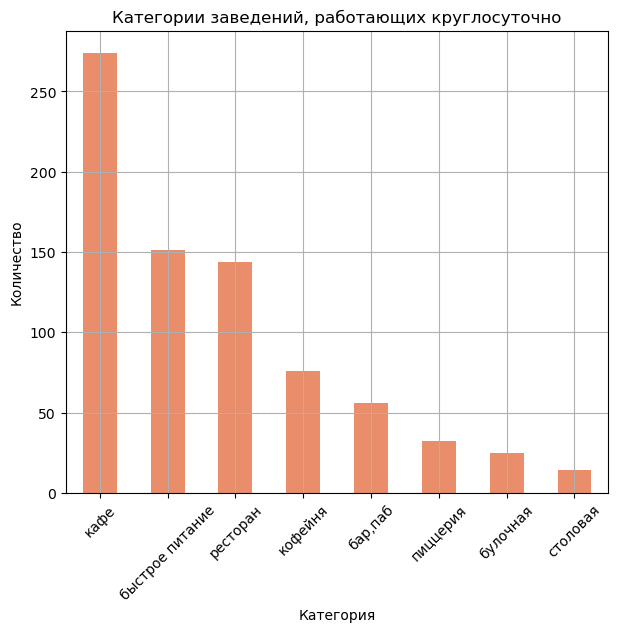

In [93]:
every_day_every_night = df[df['hours'].str.contains('круглосуточно').fillna(False)]
print(every_day_every_night.shape)

category_counts = every_day_every_night.groupby('category')['name'].count().sort_values(ascending=False)

plt.figure(figsize=(7, 6))
category_counts.plot(kind='bar')
plt.grid('gridOn')
plt.xticks(rotation=45)

plt.title('Категории заведений, работающих круглосуточно')
plt.xlabel('Категория')
plt.ylabel('Количество')

plt.show()

А вот и **новые результаты**! 

Теперь мы можем увидеть интересный факт - круглосуточных кафе очень много, они явные фавориты в этом исследовании. За ними идет категория быстрого питания, что неудивительно. А вот бары и пабы - традиционно ночные заведения - действительно редко работают круглосуточно, ведь утром они закрыты. Любопытно, что существует порядка 20 круглосуточных булочных. Давайте же на них посмотрим!

In [94]:
every_day_every_night_bulki = every_day_every_night[every_day_every_night['category'] == 'булочная']

4.2


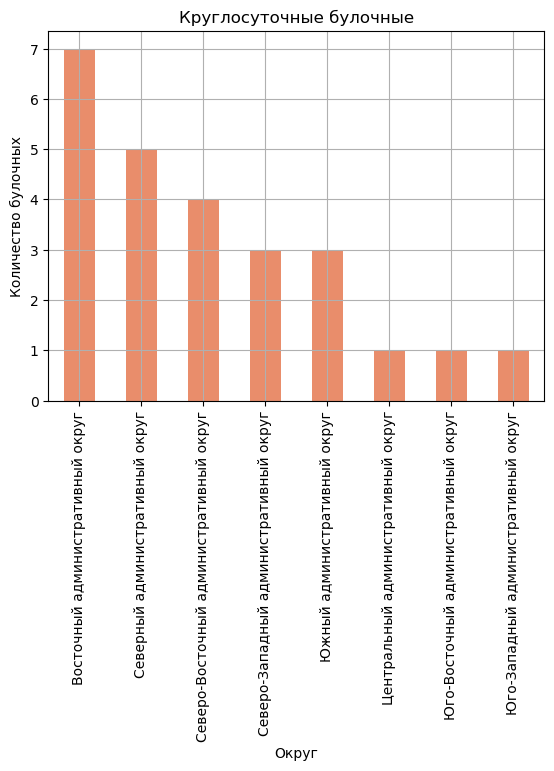

In [95]:
print(every_day_every_night_bulki.rating.median())

every_day_every_night_bulki.groupby('district')['name'].count().sort_values(ascending=False).plot(kind='bar')
plt.grid('gridOn')
plt.xticks(rotation=90)

plt.title('Круглосуточные булочные')
plt.xlabel('Округ')
plt.ylabel('Количество булочных')

plt.show()


Север, Восток и все, что между ними - районы, в которых можно пойти за булочками хоть в 2 часа ночи.

Отвлечемся от булок и перенесем все круглосуточные заведения на карту

In [96]:
# карта Мск
mos = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Круглосуточные заведения',
).add_to(mos)

marker_cluster = MarkerCluster().add_to(mos)  

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

every_day_every_night.apply(create_clusters, axis=1)

mos

Больше всего круглосуточных заведений в Центре, а также на Востоке Москвы. При этом самые качественные заведения на Севере и Северо-Востоке.

## Открытие кофейни <a id="opening"></a>

Ответим на следующие вопросы:

- Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

- Есть ли круглосуточные кофейни?

- Какие у кофеен рейтинги? Как они распределяются по районам?

- На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [97]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,Несетевые,NaN,улица Дыбенко,False,650.0
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,Несетевые,4.0,улица Дыбенко,False,650.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,Несетевые,45.0,Клязьминская улица,False,650.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевые,NaN,улица Маршала Федоренко,False,650.0
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,169.0,Сетевые,148.0,Правобережная улица,False,650.0


In [98]:
df.groupby('category')['name'].count()

category
бар,паб             765
булочная            256
быстрое питание     603
кафе               2378
кофейня            1412
пиццерия            633
ресторан           2043
столовая            315
Name: name, dtype: int64

In [99]:
coffee = df.copy()
coffee = coffee[coffee['category'] == 'кофейня']
print(coffee.shape)
coffee.head()

(1412, 17)


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевые,NaN,улица Маршала Федоренко,False,650.0
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,169.0,Сетевые,NaN,парк Левобережный,False,650.0
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,127.0,Сетевые,46.0,Коровинское шоссе,False,650.0
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,95.0,Сетевые,NaN,улица Маршала Федоренко,False,650.0
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,60.0,Сетевые,NaN,улица Дыбенко,False,650.0


In [100]:
coffee['district'] = coffee['district'].str.split().str[0]
coffee['district']

3            Северный
25           Северный
45           Северный
46           Северный
52           Северный
            ...      
8356    Юго-Восточный
8365    Юго-Восточный
8376    Юго-Восточный
8385    Юго-Восточный
8400     Юго-Западный
Name: district, Length: 1412, dtype: object

In [101]:
district_counts = coffee['district'].value_counts()

fig = px.bar(x=district_counts.index, y=district_counts.values, 
             title='Районы с наибольшим количеством кофеен',
             labels={'x': 'Район', 'y': 'Количество кофеен'},
             color_discrete_sequence=['#BC9F8B'])

fig.update_layout(xaxis_tickangle=-45)  

fig.show()

In [102]:
# карта Мск
coffe_map = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='OpenStreetMap')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Кофейни',
).add_to(coffe_map)

marker_cluster = MarkerCluster().add_to(coffe_map)  

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

coffee.apply(create_clusters, axis=1)

coffe_map

In [103]:
coffee.middle_coffee_cup.mean()

163.95264765784114

In [104]:
top_business = coffee.copy()
top_business = top_business[(top_business['rating'] >= 4.5) & (top_business['middle_coffee_cup'] >= 164)]
top_business.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевые,NaN,улица Маршала Федоренко,False,650.0
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,170.0,Сетевые,NaN,ландшафтный заказник Лианозовский,False,500.0
72,Лакрица,кофейня,"Москва, Алтуфьевское шоссе, 85",Северо-Восточный,"ежедневно, 08:00–21:00",55.891196,37.585653,4.5,средние,Цена чашки капучино:150–190 ₽,NaN,170.0,Несетевые,12.0,Алтуфьевское шоссе,False,500.0
100,Take and Wake,кофейня,"Москва, Дмитровское шоссе, 100, стр. 2",Северный,пн-пт 08:30–18:30,55.882019,37.546174,4.5,низкие,Цена чашки капучино:150–210 ₽,NaN,180.0,Сетевые,120.0,Дмитровское шоссе,False,650.0
299,Калитки,кофейня,"Москва, Фестивальная улица, 13, корп. 2",Северный,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.856284,37.476017,4.5,средние,Средний счёт:300–500 ₽,400.0,169.0,Сетевые,90.0,Фестивальная улица,False,650.0


In [105]:
#количество строк с сетевыми
setevye_count = top_business['chain'].eq('Сетевые').sum()

#сколько всего
total_count = top_business['chain'].notna().sum()

#в %
setevye_percentage = (setevye_count / total_count) * 100

print(f"Процент сетевых заведений: {setevye_percentage:.2f}%")

Процент сетевых заведений: 58.33%


Целых **58% от общего числа кофеен в выборке являются сетевыми**, остальные - частные.

In [106]:
# карта Мск
coffe_map = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='OpenStreetMap')

#хороплет 
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.5,
    legend_name='Кофейни',
).add_to(coffe_map)

marker_cluster = MarkerCluster().add_to(coffe_map)  

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

top_business.apply(create_clusters, axis=1)

coffe_map

In [107]:
top_business[top_business.is_24_7 == True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,indic
1047,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, вл3с3",Северо-Восточный,"ежедневно, круглосуточно",55.851778,37.676423,4.5,NaN,Цена чашки капучино:140–200 ₽,NaN,170.0,Сетевые,NaN,Ярославское шоссе,True,500.0
1790,Кофемания,кофейня,"Москва, Ленинградский проспект, 37А, корп. 14,...",Северный,"ежедневно, круглосуточно",55.790899,37.542776,4.7,NaN,NaN,NaN,169.0,Сетевые,15.0,Ленинградский проспект,True,650.0
3366,You&coffee,кофейня,"Москва, 4-я Магистральная улица, 5, стр. 1",Северный,"ежедневно, круглосуточно",55.774512,37.520563,4.7,NaN,NaN,NaN,169.0,Сетевые,20.0,4-я Магистральная улица,True,650.0
3685,Кофемания,кофейня,"Москва, Большая Никитская улица, 13",Центральный,"ежедневно, круглосуточно",55.756507,37.604838,4.5,высокие,Средний счёт:2500 ₽,2500.0,169.0,Сетевые,148.0,Большая Никитская улица,True,1000.0
3688,Кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,169.0,Сетевые,200.0,улица Новый Арбат,True,1000.0
4756,Кофемания,кофейня,"Москва, Трубная площадь, 2",Центральный,пн 06:00–00:00; вт-вс круглосуточно,55.766739,37.621862,4.5,высокие,Средний счёт:1500–2500 ₽,2000.0,169.0,Сетевые,120.0,Трубная площадь,True,1000.0
6558,Wild Bean Cafe,кофейня,"Москва, Ленинский проспект, 137Ас1",Юго-Западный,"ежедневно, круглосуточно",55.643246,37.471251,4.5,NaN,NaN,NaN,170.0,Сетевые,NaN,Ленинский проспект,True,600.0


In [108]:
top_business[top_business['district'] == 'Северо-Восточный'].groupby('hours')['hours'].count()

hours
ежедневно, 07:00–22:00                  1
ежедневно, 08:00–21:00                  1
ежедневно, 08:00–22:00                  2
ежедневно, 08:00–23:00                  1
ежедневно, 09:00–21:00                  1
ежедневно, 10:00–22:00                  1
ежедневно, круглосуточно                1
пн-пт 07:30–22:00; сб,вс 09:00–22:00    1
пн-пт 08:00–00:00; сб,вс 08:00–18:00    1
пн-пт 08:00–21:00; сб,вс 09:00–21:00    2
пн-пт 09:00–19:00; сб,вс 10:00–17:00    1
пн-пт 10:00–22:00; сб,вс 09:00–23:00    1
пн-сб 08:00–23:00; вс 09:00–22:00       1
Name: hours, dtype: int64

In [109]:
top_business.seats.median()

70.0

Всего у нас представлено 1413 кофеен.

Как и ожидалось, больше всего кофеен в Центральном районе - 482, за ним следуют Северный со 193 кофейнями и Северо-Восточный с 159. Меньше всего кофеен в Северо-западном районе - всего 62

Мы перенесли на карту расположение кофеен по районам и посмотрели поближе на Центральный. Что можно сказать про заведения это категории? Например, рассмотрим один из самых густонаполненных кофейнями район - Таганский. Мы увиди, что кофейни находятся довольно близко друг к другу - но в то же время не в одном здании. Примечательно, что кофейни находятся не в отдельном помещении, а в совокупности с другими местами. Например, часто можно встретить кофейню по соседству с общепитом, банком, метро и т.п. 

Далее меня заинтересовало расположение самых популярных кофеен с крупным чеком. В дальнейшем будем назывть их топ-кофейни. Выяснилось, что наибольшее количесвто топ-кофеен не являются сетевыми, то есть нашему заказчику не обязаткльно покупать франшизу и развиваться под чужим лейблом, самостоятельная кофейня будет пользоваться не меньшим спросом. Однако тут стоит большое внимание уделить **интерьеру и дизайну**. Изучив информацию из доступных источников (отзывы посетителей в Интернете), можно прийти к заключению, что первое, на что обращают внимание посетители - красота и атмосфера заведения (так, например, было с Atelier de Tartelettes и "Борис Сонный"), только потом уже идет оценка вкуса кофе и ослуживания. Так что для *привлечения* клиентов стоит уделить внимание именно этим критериям, а для *удержания* необходимо закупать качественные зерна и обучать персонал.

Больше всего топ-заведений (а, следовательно, и больше конкуренции) находятся в Центральном районе либо в переулках близ самых проходимых мест столицы (Садовое кольцо, Сретенский бульвар) либо в популярных туристических (а также "понтовых") местах - близ Патриарших прудов, Малая Бронная и т.п. Если же центр слишком дорого - можно рассмотреть Север. Здесь принцип расположения схож - достаточно выбрать оживленную улицу или в местах большого скопления людей - школы, поликлинники, бизнес-центры и т.п.

Существуют ли среди выбранных круглосуточные кофейни? Да, их немного, и это сеть "Wild Bean Cafe", а также некоторые точки "Кофемании" и 1 от "You&coffeе". Остальные кофейни не работают по ночам.

**На какую стоимость чашки стоит ориентироваться при открытии кофейни?**

Для этого нужно сначала определеиться с расположением кофейни и с концепцией заведения. Например, будет ли она работать круглосуточно, как в случае с "Wild Bean Cafe" или нет, какие позиции помимо кофе будет предлагать, какие зерна и оборудование использовать, наколько "продвинутый" бариста будет работать и т.п.

При анализе рекомендаций я ориентировалась на выборку заведений с высоким рейтингом и высоким чеком, поскольку считаю, что первый показатель - это то, на что нужно ориентироваться, а второй - то, с чего начнет заказчик.

Начнем с местоположения, так как это основополагающая часть при установке цены- я нашла 2 наиболее подходящих по разным критериям для подающего надежды новичка мест. Поскольку у клиента уже есть стратегия в продвижении бренда и его видение как таковое (кофейня в стиле сериала Френдс). Зная, как стильно выглядит оригинал кофейни в сериале, несложно представить аналог в Москве где-нибудь в Центральном округе. Это и есть первая рекомендация по расположению. Вот, напрмер, метро Сухаревская. Рядом расположились Театр Олега Табакова, театральный центр, психолого-педагогический университет. Высока вероятность того, что людям, посещающим эти места, понравится концепция заведения + наличие жилого комплекса обеспечит большую проходимость. По данным с сайта аренды недвижимости Циан (https://www.cian.ru/map/?deal_type=rent&engine_version=2&offer_type=offices&office_type%5B0%5D=5&region=1&specialty_types%5B0%5D=7085&zoom=12&center=55.77088007186378,37.635416595737375), в этой области можно арендовать помещение от 100 тыс.руб. до 1 млн.руб. Догоровато, зато место хорошее. Средний чек за чашку кофе у заведений поблизости - 181 руб., рейтинг соответствует - 4.5-4.6

Другой вариант, если в центре дороговато - Север и Северо-восток Москвы, но не слишком далеко от центра, ведь так шанс остаться незамеченными выше. Например, около ВДНХ. Средний чек заведений поблизости высок - в среднем 232.5, примерно такой будет цена чашечки в нашем заведении в случае расположения здесь. Из недостатков - конкуренты представлены популярными известными сетями - джеффри и Шоколадница. Снова обратимся к сайту Циан для уточнения информации о стоимости аренды нежилых помещений. Как и ожидалось, в отличие от Центра, предложений здесь в разы больше и стоят они куда демократичнее - цены стартуют от 150 тыс.руб.

    Для дальнейших рекомендаций я предположила, что клиент предпочел открыться на Северо-востоке и, следовательно, установил цену чашки кофе в районе 232 руб.

Теперь разберемся с концепцией заведения - как уже упоминалось выше, повторение стиля кофейни из сериала "Друзья", скорее всего, заинтересует целевую аудиторию сериала, то есть молодые люди 30 - 35 лет. Круглосуточные заведения больше подойдут для целевой аудитории помоложе (18-25), а следовательно нет смысла перегружать ресурсы и делать кофейню 24/7. Чуть выше проведено исследование в какие часы чаще всего работают кофейни в Северном округе. Судя по полученным результатам, наиболее удобное для потребителей расписание - ежедневно, с 8 утра до 9 или 10 вечера, это больше зависит от того, в какие часы клиентов приходит больше, к тому же расписание можно откорректировать в дальнейшем, однако мои рекомендации для начала - придерживаться более "общего" расписания.

Осталось определиться с количеством посадочных мест. Конечно, это во многом зависит от размера арендуемого помещения. Однако стоит знать примерные ориентиры. Посмотрев на медианное значение, определим ориентир - 60 мест.

In [110]:
place_lat, place_lng = 55.825961, 37.649334

m = folium.Map(location=[place_lat, place_lng], zoom_start=16, tiles='OpenStreetMap')

# сохраняем URL-адрес изображения иконки
icon_url = 'https://img.icons8.com/?size=100&id=n6KZEO6A5r0J&format=png&color=000000'

# создаём объект CustomIcon с иконкой
icon = CustomIcon(icon_url, icon_size=(50, 50))

# создаём маркер с иконкой
marker = folium.Marker([place_lat, place_lng], icon=icon, tooltip="Friends' Cafe")
# добавляем маркер на карту
marker.add_to(m)

# выводим карту
m

На карте выше я отметила одно из мест, выставленных на Циане для аренды и соответствующих результатам проведенного анализа.

## Презентация для заказчика <a id="present"></a>

Презентация: <https://drive.google.com/file/d/1P_MSolPcfIuVRfTQY3aLFMSeNUkWF9Eb/view?usp=sharing>

## Выводы <a id="ending"></a>

 - Cамые частые типы заведений - кафе (2378 заведений), рестораны (2043),
кофейни (1413)

 - Больше всего посадочных мест в ресторанах - 86

 - Cетевых заведений меньше, чаще всего это кафе. Cамые популярные: Шоколадница, Домино, До-До

 - Больше всего заведений в ЦАO, меньше всего - в CЗАO

 - Наиболее высокий рейтинг у заведений в ЦАО и САО

 - Самая популярная улица - проспект Мира

 - Самые дорогие районы - Центр и Запад

 - Среди круглосуточных заведений больше всего кафе
 
 
 Заказчику выгоднее всего будет выбрать Северный или Северно-Восточный районы для открытия кофейни, среднюю цену чашки кофе можно установить 232 руб.